# Lodging structures classifier in Lombardy, Italy

In [32]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import graphviz
import re
import os
from sklearn.metrics import accuracy_score
from sklearn.feature_selection import RFECV
from pandas_ml import ConfusionMatrix
from sklearn.metrics import confusion_matrix
from sklearn.svm import SVC
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.tree import export_graphviz
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split

%matplotlib inline

data_0 = pd.read_csv('classification_dataset.csv', sep='\t') 
data = data_0

extra = pd.read_csv('cusersplenevicidocumentsdocs-lavorockancvsxr2pacomuniitaliani24102017 (1).csv', sep=None,  engine='python')

# Data Cleaning and Features Extraction

In [33]:

#ID
data.drop(['ID'], axis=1, inplace=True)

In [34]:

#LOCALITA
data['LOCALITA'] = data['LOCALITA'].apply(lambda x: 0 if pd.isnull(x) else 1) 

In [35]:

#IN ABITATO
data['IN_ABITATO' ].fillna(0, inplace=True)

In [36]:

#SUL_LAGO
data['SUL_LAGO'].fillna(0, inplace=True)

In [37]:

#VICINO_ELIPORTO
data.drop(['VICINO_ELIPORTO'],axis=1, inplace=True)

In [38]:

#VICINO_AEREOPORTO
data['VICINO_AEREOPORTO'].fillna(0, inplace=True)

In [39]:

#VICINO_IMP_RISALITA
data['VICINO_IMP_RISALITA'].fillna(0, inplace=True)

In [40]:

#ZONA_CENTRALE
data['ZONA_CENTRALE'].fillna(0, inplace=True)

In [41]:

#ZONA_PERIFERICA
data['ZONA_PERIFERICA'].fillna(0, inplace=True)

#place both in ZONA_PERIFERICA and ZONA_CENTRALE =1 set to 0 on both
data[['ZONA_PERIFERICA', 'ZONA_CENTRALE']].loc[data['ZONA_PERIFERICA'] == 1].loc[data['ZONA_CENTRALE'] ==1 ]
data['ZONA_CENTRALE'].iloc[192] = 0
data['ZONA_PERIFERICA'].iloc[192] = 0

/Users/lorenzogessner/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:194: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)


In [42]:

#ZONA_STAZIONE_FS
data['ZONA_STAZIONE_FS'] = data['ZONA_STAZIONE_FS'].fillna(0)

In [43]:

#ATTREZATURE_VARIE
data['ATTREZZATURE_VARIE'] = data['ATTREZZATURE_VARIE'].fillna('').apply(lambda x: x.split(',')) #fills nan with '' and split the strings
dummies_a = pd.get_dummies(data['ATTREZZATURE_VARIE'].apply(pd.Series).stack()).sum(level=0) #extracts dummies from lists of strings
dummies_a = dummies_a.replace(2,1) #correction for repeated in the strings 
dummies_a = dummies_a[dummies_a.columns[dummies_a.sum() >= 75][1:]] #select only attrezature that appears >= 75 and drops the '' 
data = pd.concat([data, dummies_a], axis=1, join_axes=[data.index]) #joins dummies to the original df


In [44]:

#CARTE_ACCETTATE
data[['CARTE_ACCETTATE']] = data[['CARTE_ACCETTATE']].apply(lambda x: 0 if pd.isnull(x[0]) else 1, axis=1)

In [45]:

#LINGUE_PARLATE
#counting how many different languages are spoken
data['LINGUE_PARLATE'] = data['LINGUE_PARLATE'].fillna('-').apply(lambda x: x.split(','))
data['LINGUE_PARLATE'] = data['LINGUE_PARLATE'].apply(lambda x: len(x) if x[0] != '-' else 0 )

In [46]:

#SPORT
data['SPORT'] = data['SPORT'].fillna('').apply(lambda x: x.split(',')) #fills nan with '' and split the strings
dummies_s = pd.get_dummies(data['SPORT'].apply(pd.Series).stack()).sum(level=0) 
dummies_a = dummies_a.replace(2,1)

#aggregate all sports with a field
sport_con_campo = [' calcetto',' pallacanestro','Campo attrezzato per pallavolo',
'Campo da calcetto', 'Campo da calcio','Campo da pallavolo', 'Campo da tennis', 'Campo da bocce']
dummies_s['Sport_Con_Campo'] = dummies_s[sport_con_campo].sum(axis=1)

#aggregate all summer sports
sport_estivi = [' beach volley', 'Sci nautico','Sub','Vela','Windsurf']
dummies_s['Sport_Estivi'] = dummies_s[sport_estivi] .sum(axis=1)

#aggregate all winter sports
sport_invernali = ['Pattinaggio su ghiaccio', 'Sci da fondo', 'Sci montano', 'Sport invernali']
dummies_s['Sport_Invernali'] = dummies_s[sport_invernali].sum(axis=1)

#aggregate swimming pool
dummies_s['Piscina'] = dummies_s[['Piscina coperta','Piscina scoperta']].sum(axis=1)

#aggregate all indoor activiteis
sport_indoor = ['Bigliardo','Bowling','Calciobalilla', 'Tennis da tavolo']
dummies_s['Sport_Indoor'] = dummies_s[sport_indoor].sum(axis=1)

#there is 'Fitness/centro salute' also as a ATTREZATURA. I'm combinig it with the sport column
Fitness_centro_salute = pd.concat([dummies_s['Fitness/centro salute'], dummies_a['Fitness/centro salute']], axis=1, join_axes=[data.index])
data['Fitness/centro salute']  = Fitness_centro_salute.sum(axis=1).replace(2,1)

#dummify our aggregation of SPORT and combine it with our dataset
dummies_s = dummies_s[['Sport_Con_Campo','Sport_Estivi','Sport_Invernali','Piscina']]
dummies_s[dummies_s != 0] = 1 #replace values > 1 with 1 given that we summed the columns
data = pd.concat([data, dummies_s], axis=1, join_axes=[data.index]) 

In [47]:

#CONGRESSI
data['CONGRESSI'] = data['CONGRESSI'].fillna('0').apply(lambda x: re.search(r'(\d+){1}', x)[0]).astype(int)

In [48]:

#OUTPUT
#convert classes to numbers
output = {'Case_Appartamenti':1, 'Campeggio':2, 'B&B':3, '1_a_3_Stelle':4, '4_a_5_Stelle':5 }
data[['OUTPUT']] = data['OUTPUT'].map(output)

## External Dataset

In [49]:
#filter for Lombardia
extra = extra.loc[extra['Regione'] == 'Lombardia']

#drop unwanted columns
extra = extra.drop(['ISTAT', 'Regione', 'PopStraniera', 'AltezzaMinima', 'AltezzaMassima', 'ZonaSismica', 'ClasseComune', \
                    'Latitudine', 'Longitudine', 'ZonaAltimetrica', 'SuperficieKmq', 'Provincia',\
                   'AreaGeo', 'SiglaProv','IndiceMontanita', 'PopResidente'], axis =1)

In [50]:
#convert ZonaClimatica to bool F==1 the rest = 0
extra['ZonaClimatica'] = extra['ZonaClimatica'].apply(lambda x: 1 if x == 'F' else 0)

#convert to float
extra['DensitaDemografica'] = extra['DensitaDemografica'].str.replace(',','.').astype(float)
extra['AltezzaCentro'] = extra['AltezzaCentro'].astype(int)

#create bool if comune is also capoluogo 
extra['TipoComune'] = extra['TipoComune'].apply(lambda x: 0 if x == 'No capoluogo' else 1)
extra.rename(columns = {'TipoComune': 'Capoluogo'},inplace=True)

#convert GradoUrbaniz to numeric

urban_dic = {
    'Elevato': 3,
    'Medio': 2,
    'Basso':1}

extra['GradoUrbaniz'] = extra['GradoUrbaniz'].map(urban_dic)

#fixing names of comuni that are different between extra and data

extra['﻿Comune'] = extra['﻿Comune'].str.upper()

nomi_comuni = {
    'TOSCOLANO-MADERNO': 'TOSCOLANO MADERNO',
    'TREMOSINE SUL GARDA': 'TREMOSINE',
    'SALÒ': "SALO'",
    'LONATO DEL GARDA': 'LONATO',
    'PUEGNAGO DEL GARDA': 'PUEGNAGO SUL GARDA',
    'TEMÙ':"TEMU'",
    'CANTÙ': "CANTU'",
    'ROÈ VOLCIANO': "ROE' VOLCIANO",
    'GODIASCO SALICE TERME': 'GODIASCO',
    'RODENGO SAIANO': 'RODENGO-SAIANO',
    'UGGIATE-TREVANO': 'UGGIATE - TREVANO',
    'BARZANÒ': "BARZANO'",
    'GAMBOLÒ': "GAMBOLO'",
    'MUGGIÒ': 'MUGGI�',
    'GADESCO-PIEVE DELMONA': 'GADESCO - PIEVE DELMONA',
    'TRAVACÒ SICCOMARIO': "TRAVACO' SICCOMARIO",
    'VIGGIÙ':"VIGGIU'",
    'GORNATE-OLONA': 'GORNATE OLONA',
    'ALMÈ': "ALME'",
    "VILLA D'ALMÈ": "VILLA D'ALME'",
    "CASSINA DE' PECCHI" : "CASSINA DE PECCHI "}
    
extra['﻿Comune'].replace(nomi_comuni, inplace=True)



extra.rename(columns = {'﻿Comune': 'Comune'},inplace=True)


In [51]:

#union with data and extra
union = pd.merge(data, extra, how='left', left_on= data['COMUNE'], right_on= extra['Comune'])

In [52]:
#drop non numerical columns

union = union.drop(['PROVINCIA', 'COMUNE', 'LATITUDINE', 'LONGITUDINE','ATTREZZATURE_VARIE','SPORT', 'Comune'], axis=1)
union.fillna(0, inplace=True)

In [55]:
#save final dataset, now commented to no be re-run
#union.to_csv('union.csv', index=False)

In [23]:
Y = union['OUTPUT']
X = union.drop(['OUTPUT'], axis=1)

# Modeling

In [24]:
normal = MinMaxScaler()
X_scaled = normal.fit_transform(X)

/Users/lorenzogessner/anaconda3/lib/python3.6/site-packages/sklearn/preprocessing/data.py:323: DataConversionWarning: Data with input dtype uint8, int64, float64 were all converted to float64 by MinMaxScaler.
  return self.partial_fit(X, y)


In [50]:
# from sklearn.decomposition import PCA
# pca = PCA()
# X = pca.fit_transform(X)

In [25]:
X_train, X_test, Y_train, Y_test = train_test_split(X_scaled, Y, test_size=0.25, random_state=42)

In [26]:
#Feature Selection
rfe = RFECV(SVC(kernel='linear'), cv=5, scoring='accuracy', verbose=1, n_jobs=-1) #if stuck restart kernel
rfe.fit(X_train, Y_train)
X_train = rfe.transform(X_train)
X_test = rfe.transform(X_test)


Fitting estimator with 105 features.
Fitting estimator with 104 features.
Fitting estimator with 103 features.
Fitting estimator with 102 features.
Fitting estimator with 101 features.
Fitting estimator with 100 features.
Fitting estimator with 99 features.
Fitting estimator with 98 features.
Fitting estimator with 97 features.
Fitting estimator with 96 features.
Fitting estimator with 95 features.
Fitting estimator with 94 features.
Fitting estimator with 93 features.
Fitting estimator with 92 features.
Fitting estimator with 91 features.
Fitting estimator with 90 features.
Fitting estimator with 89 features.
Fitting estimator with 88 features.
Fitting estimator with 87 features.
Fitting estimator with 86 features.
Fitting estimator with 85 features.
Fitting estimator with 84 features.
Fitting estimator with 83 features.
Fitting estimator with 82 features.
Fitting estimator with 81 features.
Fitting estimator with 80 features.
Fitting estimator with 79 features.
Fitting estimator with

In [27]:
rf = RandomForestClassifier()
pipe_rf = Pipeline([
    ('rf', rf)
 ])


params_rf = {
    'rf__criterion': ['gini'],
    'rf__n_estimators': [77],
    'rf__min_samples_split': [5,6],
    'rf__class_weight': ["balanced_subsample"]
    
}


gs_rf = GridSearchCV(pipe_rf, param_grid= params_rf, n_jobs=-1 , verbose=1, cv=5)

gs_rf.fit(X_train,Y_train)
print(gs_rf.best_score_)
print(gs_rf.best_params_)
preds = gs_rf.predict(X_test)
print(accuracy_score(preds, Y_test))


Fitting 5 folds for each of 2 candidates, totalling 10 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of  10 | elapsed:    1.8s remaining:    1.2s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:    2.0s finished


0.8787640228301515
{'rf__class_weight': 'balanced_subsample', 'rf__criterion': 'gini', 'rf__min_samples_split': 5, 'rf__n_estimators': 77}
0.8996458087367178


In [93]:
#confusion matrix in a dataframe
confusion_matrix_RF= pd.DataFrame(confusion_matrix(preds, Y_test),columns= \
             ['Case_Appartamenti','Campeggio','B&B','1_a_3_Stelle','4_a_5_Stelle'], \
             index=['Case_Appartamenti','Campeggio','B&B','1_a_3_Stelle','4_a_5_Stelle'])

confusion_matrix_RF

,Case_Appartamenti,Campeggio,B&B,1_a_3_Stelle,4_a_5_Stelle
Case_Appartamenti,673,1,51,12,6
Campeggio,0,25,0,0,0
B&B,51,0,389,2,0
1_a_3_Stelle,5,1,1,355,27
4_a_5_Stelle,0,0,0,24,71


In [31]:
xgb = XGBClassifier()
pipe_xgb = Pipeline([
    ('xgb',xgb)
 ])

params_xgb = {
    'xgb__booster': ['gbtree'],
    'xgb__n_estimators': [160], #160
    'xgb__max_depth': [5],
    'xgb__reg_alpha': [0],
    'xgb__reg_lambda':[0],
    'xgb__learning_rate': [0.1],
    'xgb__gamma': [0]
    
}


gs_xgb = GridSearchCV(pipe_xgb, param_grid= params_xgb, n_jobs=-1 , verbose=-1, cv=5)

gs_xgb.fit(X_train,Y_train)
print(gs_xgb.best_score_)
print(gs_xgb.best_params_)
xgb_preds = gs_xgb.predict(X_test)
print(accuracy_score(xgb_preds , Y_test))

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  30 out of  30 | elapsed:  1.8min finished


0.8905727219051368
{'xgb__booster': 'gbtree', 'xgb__gamma': 0, 'xgb__learning_rate': 0.1, 'xgb__max_depth': 6, 'xgb__n_estimators': 175, 'xgb__reg_alpha': 0.0, 'xgb__reg_lambda': 0}
0.9049586776859504


In [94]:
#builds a confusion matrix in a dataframe
confusion_matrix_XGB= pd.DataFrame(confusion_matrix(xgb_preds, Y_test),columns= \
             ['Case_Appartamenti','Campeggio','B&B','1_a_3_Stelle','4_a_5_Stelle'], \
             index=['Case_Appartamenti','Campeggio','B&B','1_a_3_Stelle','4_a_5_Stelle'])

confusion_matrix_XGB

,Case_Appartamenti,Campeggio,B&B,1_a_3_Stelle,4_a_5_Stelle
Case_Appartamenti,705,0,60,8,4
Campeggio,0,25,0,0,0
B&B,21,0,380,1,0
1_a_3_Stelle,3,2,1,362,28
4_a_5_Stelle,0,0,0,22,72


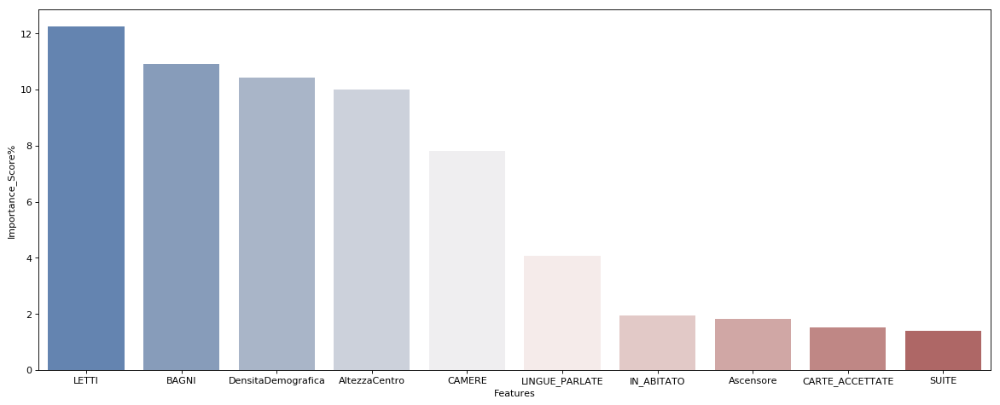

In [28]:
model = XGBClassifier(n_estimators=160, max_depth=5)
model.fit(X, Y)

# find the relative importance of each attribute
feature_scores = model.feature_importances_

#creates a dataframe to combine feature names and importance score
feature_importance = pd.DataFrame({'Features':X.columns, 'Importance_Score%':feature_scores*100})\
                            .sort_values(by='Importance_Score%', ascending=False).reset_index(drop=True)

fig=plt.figure(figsize=(18, 7), dpi= 80, facecolor='w', edgecolor='k')  
sns.barplot(feature_importance['Features'].head(10) , feature_importance['Importance_Score%'].head(10),\
            palette='vlag');


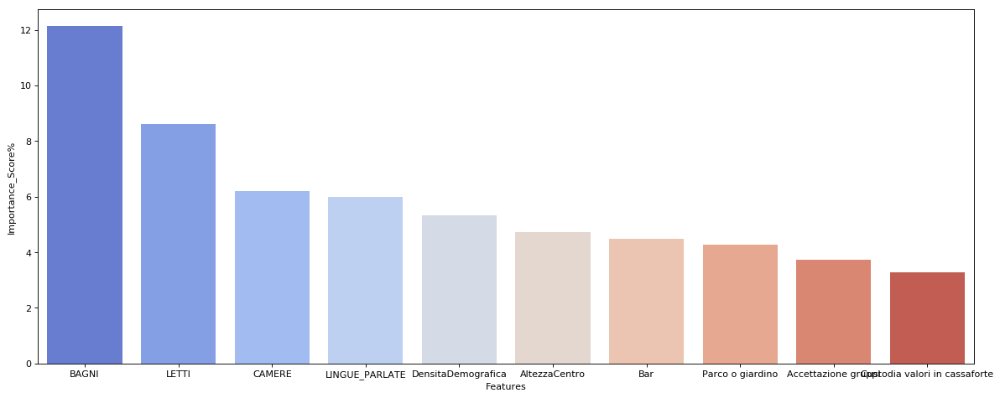

In [276]:
model = RandomForestClassifier()
model.fit(X, Y)

# display the relative importance of each attribute
feature_scores = model.feature_importances_

#creates a dataframe to combine feature names and importance score
feature_importance = pd.DataFrame({'Features':X.columns, 'Importance_Score%':feature_scores*100})\
                            .sort_values(by='Importance_Score%', ascending=False).reset_index(drop=True)


    fig=plt.figure(figsize=(18, 7), dpi= 80, facecolor='w', edgecolor='k')  
sns.barplot(feature_importance['Features'].head(10) , feature_importance['Importance_Score%'].head(10),\
            palette='coolwarm');


In [245]:
model_limited = RandomForestClassifier(max_depth=3)
model_limited.fit(X, Y)
print(model_limited.score(X,Y))


estimator = model_limited.estimators_[0] #index picks which tree to print

export_graphviz(estimator, out_file='tree.dot', 
                feature_names = X.columns,
                class_names = data_0['OUTPUT'],
                rounded = True, proportion = False, 
                precision = 2, filled = True)


# Convert to png 
call(['dot', '-Tpng', 'tree.dot', '-o' 'tree.png', '-Gdpi=600'])
Image(filename = 'tree.png')

0.7821402214022141


0.770479704797048


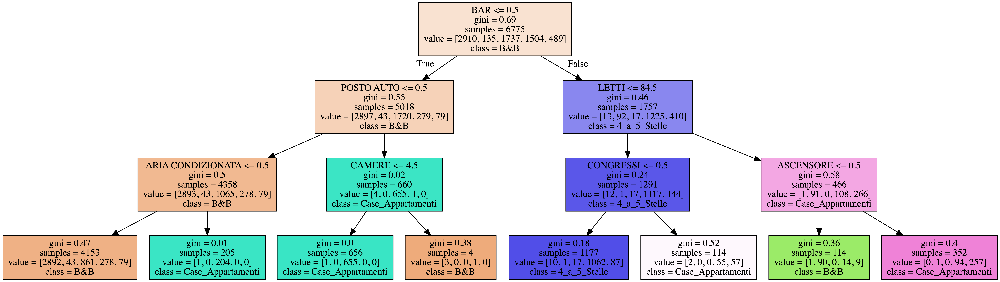

In [230]:
#printing a possible DecisionTreeClassifier with max_depth = 3
clf = tree.DecisionTreeClassifier(max_depth=3)
clf.fit(X, Y)

tree.export_graphviz(clf, out_file='tree.dot',
                feature_names = X.columns.str.upper(),
                class_names = data_0['OUTPUT'],
                rounded = True, proportion = False, 
                precision = 2, filled = True)

call(['dot', '-Tpng', 'tree.dot', '-o' 'tree.png', '-Gdpi=600'])

print(clf.score(X,Y))
Image(filename = 'tree.png')